In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import os
from matplotlib.table import Table
from matplotlib.patches import Patch

In [2]:
datasets=["youtube","dblp","amazon"] + ["lj"] * 8 + ["orkut"] * 3
dataset_min_nodes=[16,16,21] + list(range(51,131,10)) + [151,251,351]
dataset_max_nodes=[20,20,25] + list(range(55,135,10)) + [155,255,355]

sources=["node2vec","deepWalk"]
targets=["TransE","TransH", "TransD", "SimplE", "RESCAL", "DistMult"]

methods=[('source','source2target'),('source','target'),('source','transformed'),
         ('source2target','target'),('source2target','transformed'), ('target','transformed')]

method_labels=[('Source','Finetuned'),('Source','Target'),('Source','Transformed'),
         ('Finetuned','Target'),('Finetuned','Transformed'), ('Target','Transformed')]

measures = ["MRR", "MR", "Hit@10", "Hit@3", "Hit@1"]
dim=32
split='test'

In [3]:
def get_label_color(method):
    method = method.lower()
    labels=['source','finetuned','transformed','target']
    colors = ['C2','C1','C3','C5']
    for label,color in zip(labels,colors):
        if label == method:
            return color

In [4]:
plot_type = 'anova'
plot_path = os.path.join('../plots/', str(dim), plot_type)
df = pd.read_csv('../data/' + plot_type + '.csv')
if not os.path.exists(plot_path):
    os.makedirs(plot_path)

In [5]:
df.columns

Index(['DATASET', 'SIZE', 'DIM', 'SOURCE', 'TARGET', 'SPLIT', 'MEASURE',
       'METHOD', 'METHOD2', 'meandiff', 'p-adj', 'lower', 'upper', 'reject'],
      dtype='object')

In [6]:
df.head()

,DATASET,SIZE,DIM,SOURCE,TARGET,SPLIT,MEASURE,METHOD,METHOD2,meandiff,p-adj,lower,upper,reject
0,lj,121-125,32,node2vec,DistMult,test,MRR,source,source2target,0.0000,0.900,-0.0175,0.0175,False
1,orkut,351-355,32,node2vec,TransD,test,MRR,source,source2target,0.0536,0.001,0.0385,0.0687,True
2,lj,121-125,32,deepWalk,SimplE,test,MRR,source,source2target,0.0001,0.900,-0.0090,0.0092,False
3,youtube,16-20,32,deepWalk,TransD,test,MRR,source,source2target,0.1906,0.001,0.1248,0.2563,True
4,lj,121-125,32,node2vec,TransH,test,MRR,source,source2target,0.0887,0.001,0.0611,0.1164,True


In [7]:
def get_row(dataset, min_nodes, max_nodes, dim, source, 
             target, measure, split, method1, method2):
    
    graph_size = str(min_nodes) + '-' + str(max_nodes)

    filt = (df['DATASET'] == dataset) & (df['SIZE'] == graph_size) & (df['DIM'] == dim) & \
        (df['SOURCE'] == source) & (df['TARGET'] == target) & (df['MEASURE'] == measure) & \
        (df['SPLIT'] == split) & (df['METHOD'] == method1) & (df['METHOD2'] == method2)

    row = df.loc[filt]
    return row

========================MRR=======================
========================MR=======================
========================Hit@10=======================
========================Hit@3=======================
========================Hit@1=======================


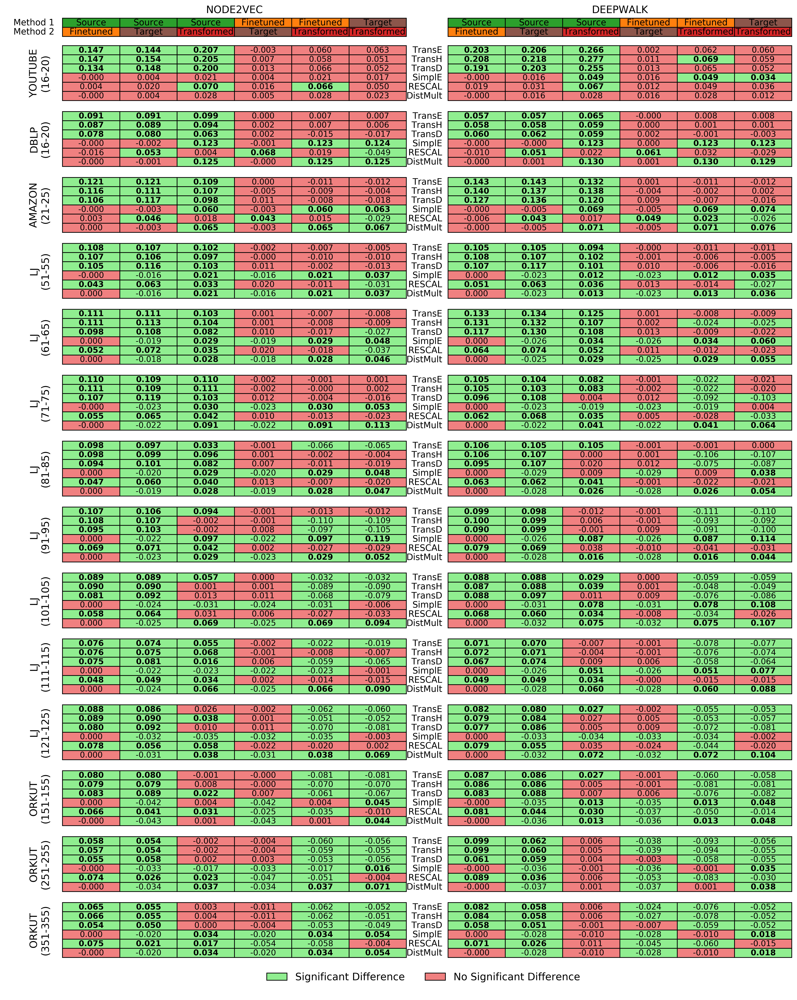

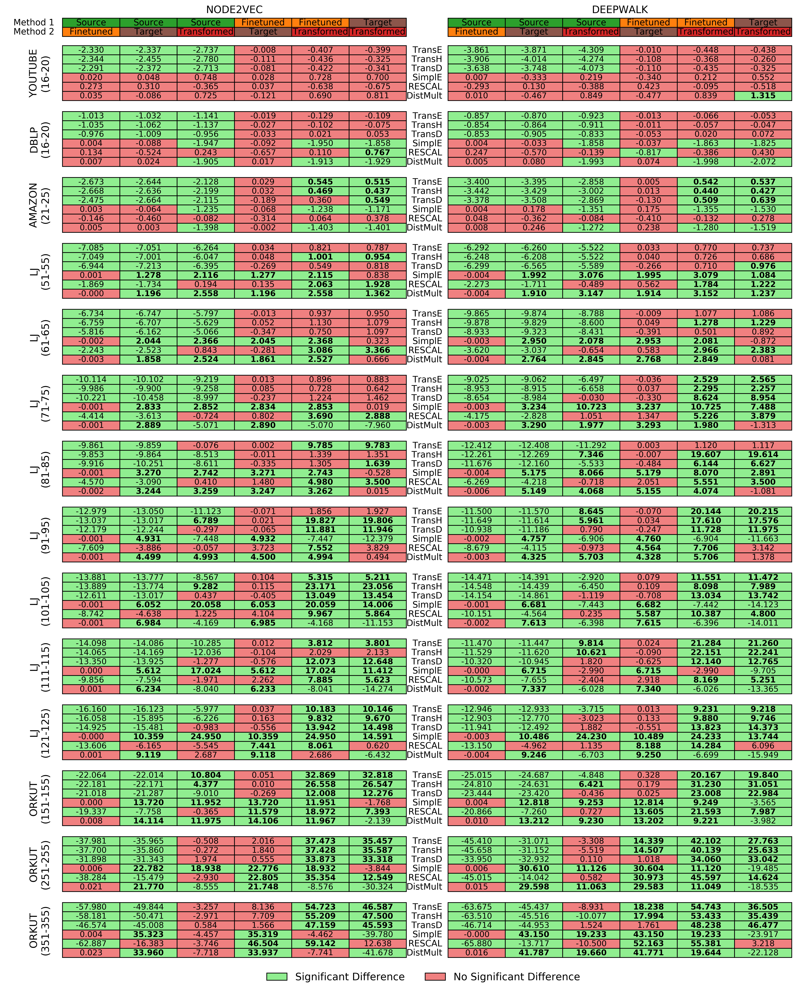

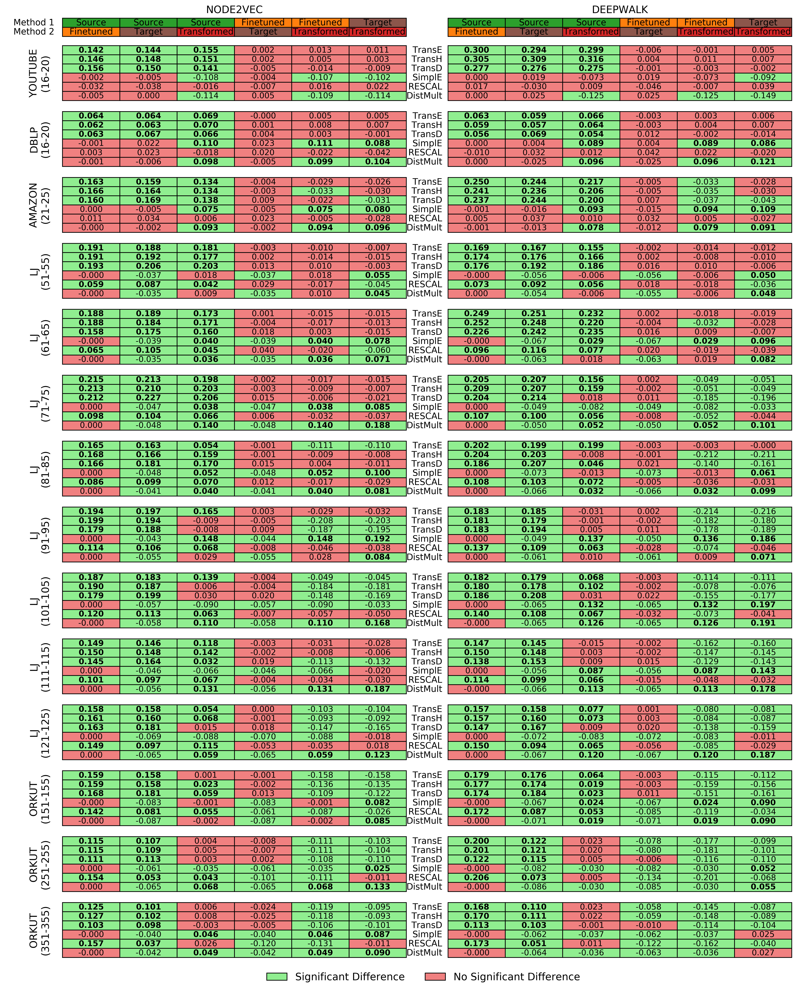

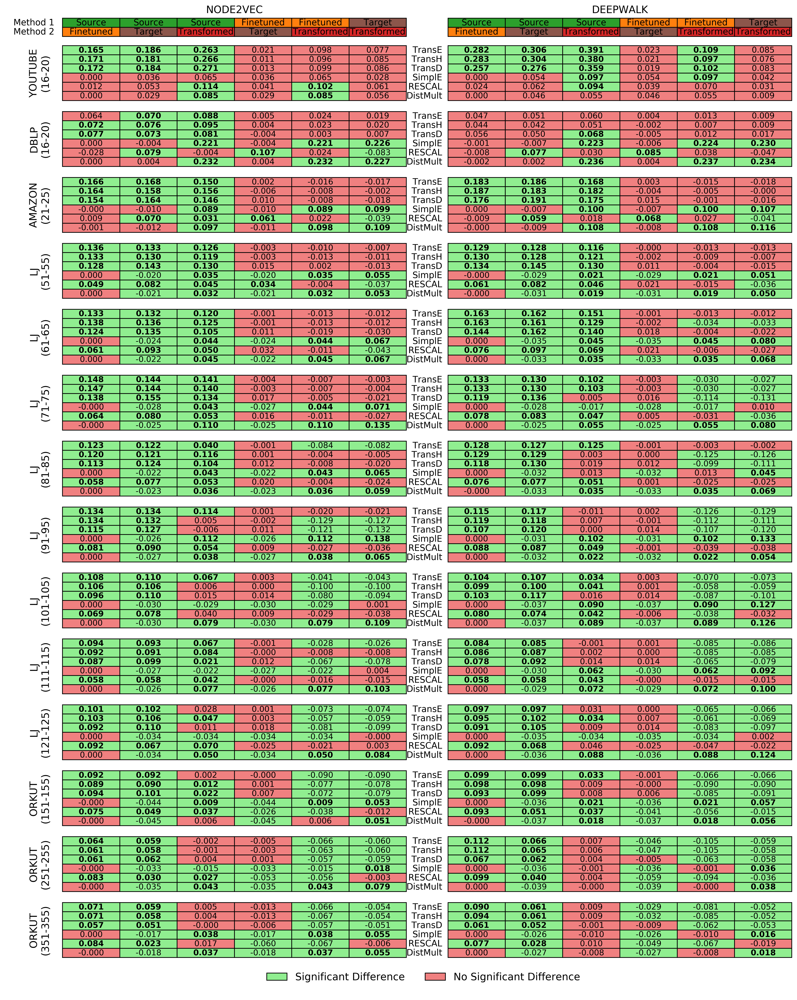

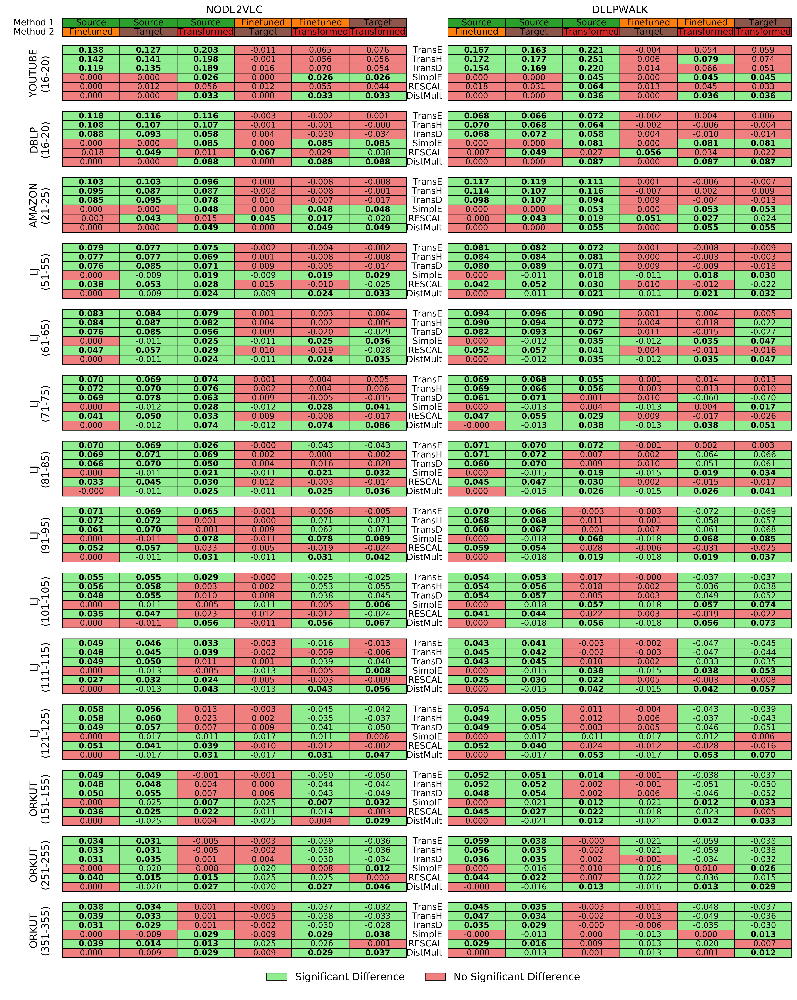

In [8]:
nrows = len(targets)
ncols = len(methods)
width, height = 1.0 / ncols, 1.0 / nrows

for measure in measures:
    print('========================' + measure + '=======================')
    fig = plt.figure(figsize=(18,21),dpi= 400, facecolor='w', edgecolor='k')
    subplot=1
    for k, dataset in enumerate(datasets):
        for source in sources:

            ax = fig.add_subplot(len(datasets),len(sources),subplot)

            # Create Table
            tb = Table(ax, bbox=[0,0,1,1])
            tb.auto_set_font_size(False)
            #tb.set_fontsize(12)

            # Add Cells
            for i, target in enumerate(targets):
                for j, method in enumerate(methods):
                    method1, method2 = method
                    row = get_row(dataset, dataset_min_nodes[k], dataset_max_nodes[k], 
                                  dim, source, target, measure, split, method1, method2)
                    reject = row['reject'].item()
                    cell_value = row['meandiff'].item()
                    color =  'lightgreen' if reject else 'lightcoral'
                    #edge_color = 'blue' if reject and float(cell_value) > 0 else 'black'
                    cell = tb.add_cell(i, j, width, height, text='{:.3f}'.format(cell_value), loc='center', 
                                facecolor=color)
                    cell.set_fontsize(11)
                    if reject and float(cell_value) > 0:
                        cell.set_text_props(fontweight='bold')


            if subplot % 2 == 0: # Row Labels
                for i, label in enumerate(targets):
                    cell = tb.add_cell(i, -1, width, height, text=label, loc='right', 
                            edgecolor='none', facecolor='none')
                    cell.set_fontsize(12)


            if subplot <=2 : # Column Labels

                for j, method in enumerate(method_labels):
                    method1, method2 = method

                    cell = tb.add_cell(-1, j, width, height, text='', loc='center', 
                                       edgecolor='none', facecolor='none')

                    cell = tb.add_cell(-2, j, width, height, text=method2, loc='center', 
                                       edgecolor='black', facecolor=get_label_color(method2))
                    cell.set_fontsize(12)

                    cell = tb.add_cell(-3, j, width, height, text=method1, loc='center', 
                                       edgecolor='black', facecolor=get_label_color(method1))
                    cell.set_fontsize(12)


                    if subplot==1 and j == 0:
                        cell = tb.add_cell(-1, -1, width, height, text='', loc='center', 
                                       edgecolor='none', facecolor='none')
                        cell.set_fontsize(12)

                        cell = tb.add_cell(-2, -1, width, height, text='Method 2', loc='center', 
                                       edgecolor='none', facecolor='none')
                        cell.set_fontsize(12)

                        cell = tb.add_cell(-3, -1, width, height, text='Method 1', loc='center', 
                                       edgecolor='none', facecolor='none')
                        cell.set_fontsize(12)



            ax.add_table(tb)

            if subplot%2 == 1:
                graph_size = str(dataset_min_nodes[k]) + '-' + str(dataset_max_nodes[k])
                ax.set_ylabel('{}\n({})'.format(dataset.upper(), graph_size),fontsize=14,labelpad=10)
                ax.xaxis.set_visible(False)
                ax.set_yticklabels([])
                ax.yaxis.set_ticks_position('none') 
            else:
                ax.set_axis_off()

            if subplot <= 2:
                ax.set_title(source.upper(),fontsize=14,pad=45)

            subplot += 1

    plt.subplots_adjust(hspace=0.2, wspace=0.121, bottom=0.05)
    legend_elements = [Patch(facecolor='lightgreen', edgecolor='black'),
                       Patch(facecolor='lightcoral', edgecolor='black')]
    legend_labels = ['Significant Difference',
                    'No Significant Difference']
    fig.legend(legend_elements,legend_labels,loc='lower center',borderpad=0,bbox_to_anchor= (0.45, 0.03), ncol=2, 
                 borderaxespad=-1.5,frameon=False, fontsize=14)
    fig.savefig(os.path.join(plot_path,measure + '.png'), bbox_inches='tight')